# ***but du notebook***
## comparer la netteté des images associées à différentes catégories de produits
Ce notebook utilise la bibliothèque OpenCV pour charger des images.  
La netteté est mesurée pour chaque image, et les résultats sont analysés statistiquement pour comprendre   
comment la netteté varie entre les catégories de produits.


### Lecture de la configuration pour obtenir les chemins de base des dossiers de données et d'images.

In [2]:
import configparser
config = configparser.ConfigParser()
files_read = config.read('D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/Rakuten_config.ini') 
print("Fichiers lus :", files_read)
#config.read('/content/drive/MyDrive/Colab_Notebooks/Rakuten_config_colab.ini')
def get_RACINE_DOSSIER() :
    return config['DOSSIER']['RACINE_DOSSIER']
def get_RACINE_IMAGES() :
    return config['DOSSIER']['RACINE_IMAGES']
print( get_RACINE_DOSSIER())   
print( get_RACINE_IMAGES())   

Fichiers lus : ['D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/Rakuten_config.ini']
D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/input/
D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/


In [ ]:
### importation de bibliothèques

In [3]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
import matplotlib.pyplot as plt
import os
import cv2

### Chargement des Données

In [4]:
# lecture des données sources d'entrainement
df_feats=pd.read_csv(get_RACINE_DOSSIER() + 'X_train_update.csv')

# lecture des données cibles d'entrainement
df_target=pd.read_csv(get_RACINE_DOSSIER() + 'Y_train_CVw08PX.csv')


# création d'un dataframe globale -  jointure
df=df_feats.merge(df_target,on='Unnamed: 0',how='inner')
df.rename(columns={'Unnamed: 0': 'Id'}, inplace=True)
cat=df_target['prdtypecode'].sort_values().unique()
cat
nomenclature=pd.read_csv(get_RACINE_DOSSIER() + 'NOMENCLATURE.csv',header=0,encoding='utf-8',sep=';',index_col=0)
catdict=nomenclature.to_dict()['definition']

#### Aperçu des données 

In [5]:
df_feats.head(5)

,Unnamed: 0,designation,description,productid,imageid
0,0,Olivia: Personalisiertes Notizbuch / 150 Seite...,NaN,3804725264,1263597046
1,1,Journal Des Arts (Le) N° 133 Du 28/09/2001 - L...,NaN,436067568,1008141237
2,2,Grand Stylet Ergonomique Bleu Gamepad Nintendo...,PILOT STYLE Touch Pen de marque Speedlink est ...,201115110,938777978
3,3,Peluche Donald - Europe - Disneyland 2000 (Mar...,NaN,50418756,457047496
4,4,La Guerre Des Tuques,Luc a des id&eacute;es de grandeur. Il veut or...,278535884,1077757786


In [6]:
df_target.head(5)

,Unnamed: 0,prdtypecode
0,0,10
1,1,2280
2,2,50
3,3,1280
4,4,2705


#### Création de noms d'image et copie du DataFrame :
Ajout d'une colonne nom_image pour nommer les fichiers d'images basés sur imageid et productid,  
puis création d'une copie du DataFrame pour une utilisation future.

In [7]:
df['nom_image']=df.apply(lambda row: "image_" +  str(row['imageid']) 
                                     + "_product_" + str(row['productid']) + ".jpg",axis=1)
print("Nb enreg ", str(df.shape[0]))
df.head(5)
df_img=df.copy()

Nb enreg  84916


### chargement des images et mesure de la netteté  
On utilise l'analyse des gradients via un filtre de Laplacien, et on identifie visuellement les images qui ont une netteté en dehors des plages normales. Cela est utilisé pour essayer de trouver si il y a un lien entre nettete et catégorie.

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215528427_product_3470070175.jpg
Sharpness: 4581.124891986544


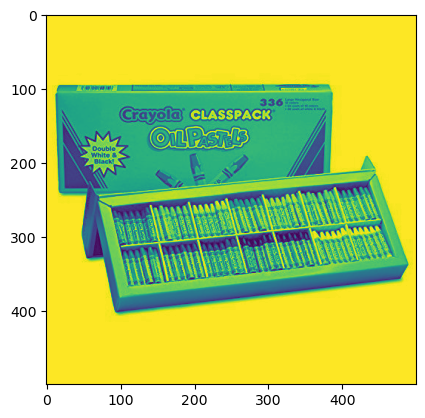

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1320002064_product_4221177716.jpg
Sharpness: 3910.4707516495355


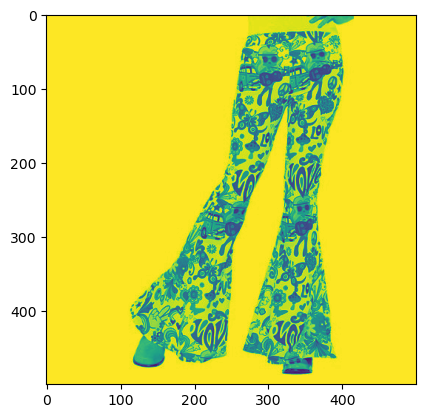

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242126135_product_3762644070.jpg
Sharpness: 4278.631537433024


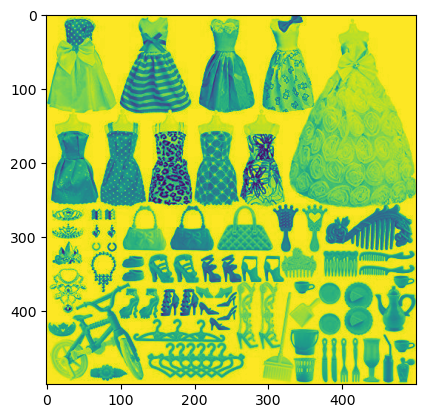

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987348819_product_294185126.jpg
Sharpness: 6256.518026765423


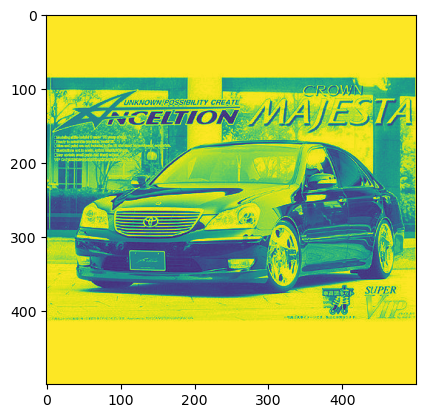

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1318786307_product_4217852988.jpg
Sharpness: 14.049055956735996


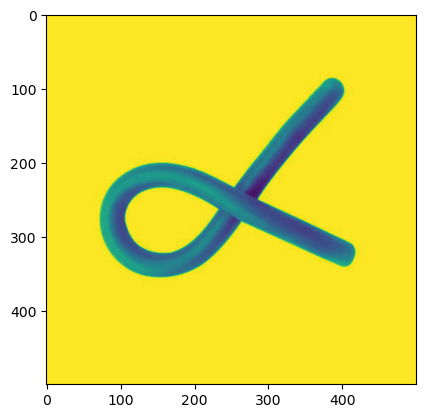

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240119913_product_3743383540.jpg
Sharpness: 4388.660498863105


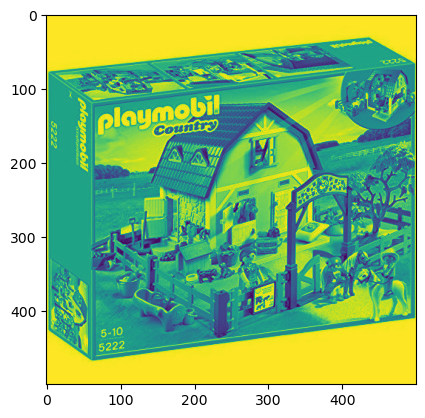

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215231963_product_3469590924.jpg
Sharpness: 7680.7722174201435


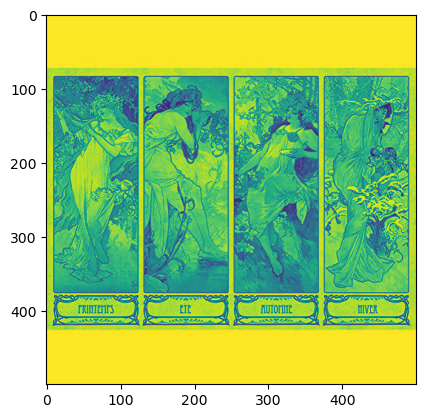

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1271444953_product_3976920344.jpg
Sharpness: 12.027131452400004


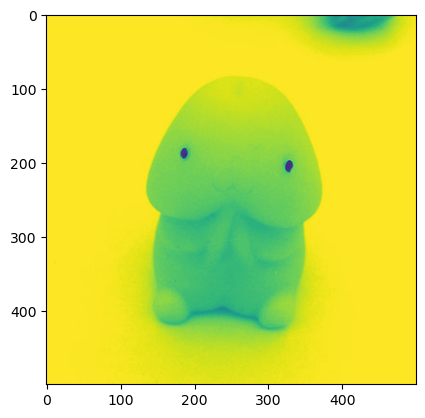

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_924251436_product_175413112.jpg
Sharpness: 7317.286624


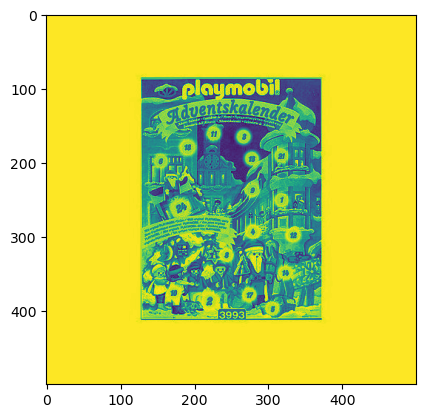

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1320225003_product_4215694880.jpg
Sharpness: 1.312776


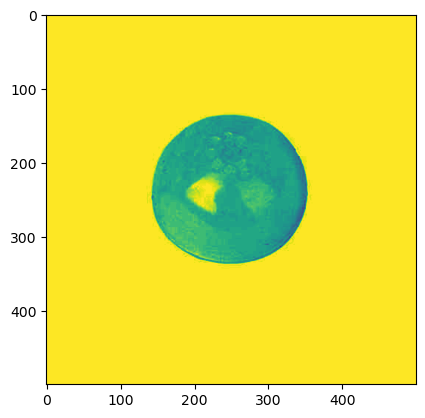

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987625852_product_294460061.jpg
Sharpness: 7063.239544


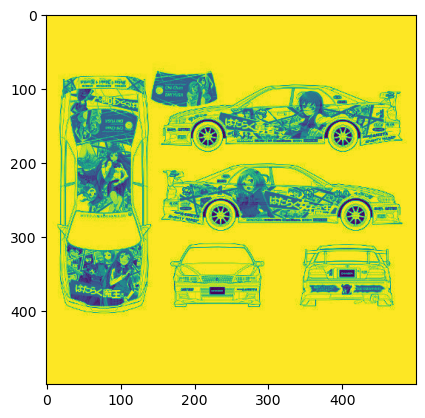

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1261195300_product_3898711669.jpg
Sharpness: 11.68068


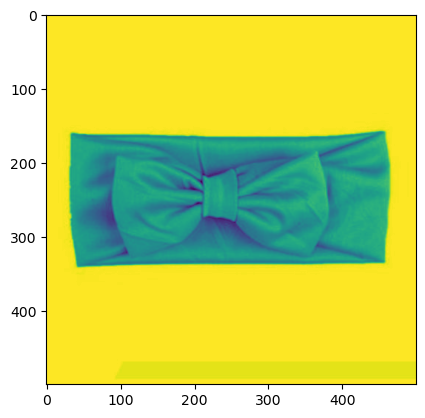

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1128286954_product_2140485856.jpg
Sharpness: 3854.762896


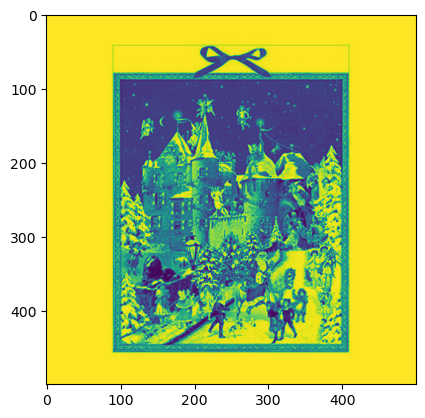

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242125356_product_3762643491.jpg
Sharpness: 3530.1544234930557


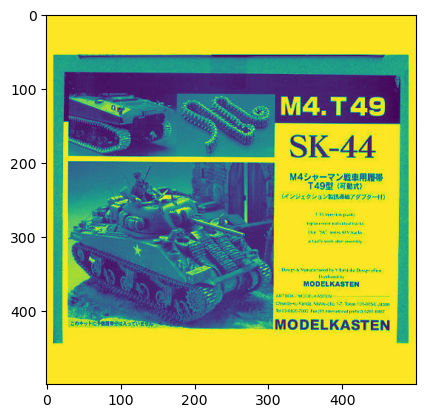

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1018397217_product_510790446.jpg
Sharpness: 4993.350830834623


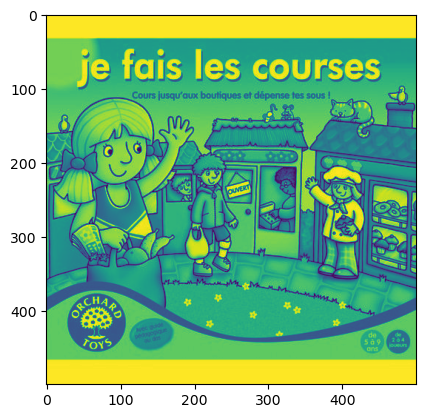

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1307268773_product_4171074435.jpg
Sharpness: 14.560744


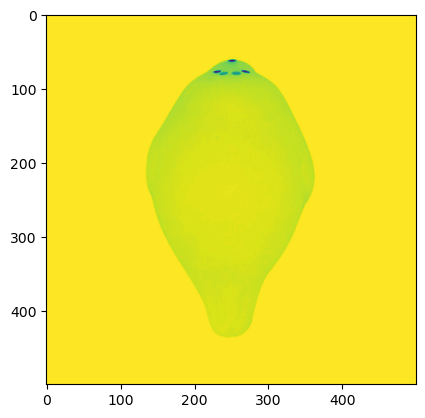

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1261183875_product_3898711376.jpg
Sharpness: 8.071439686400002


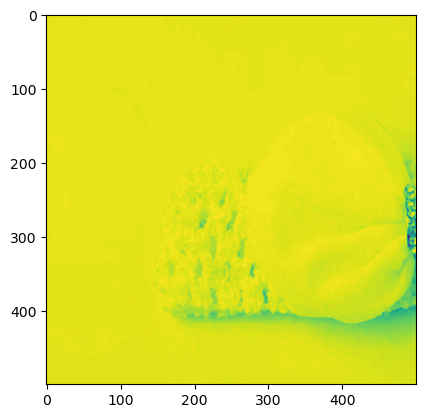

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242124374_product_3762635288.jpg
Sharpness: 14197.608576433664


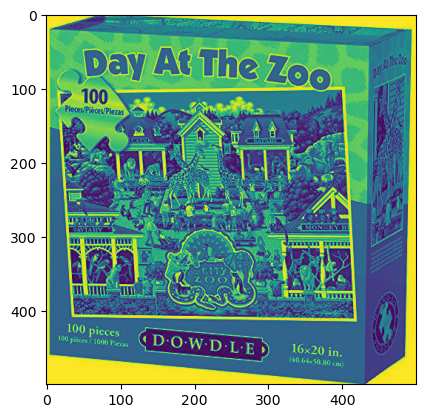

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215231384_product_3469590478.jpg
Sharpness: 6157.100899978097


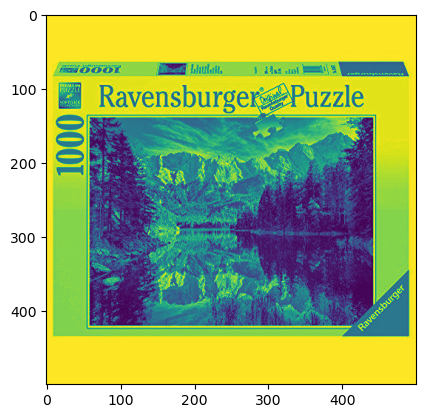

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1146401776_product_2373489644.jpg
Sharpness: 4410.267361907186


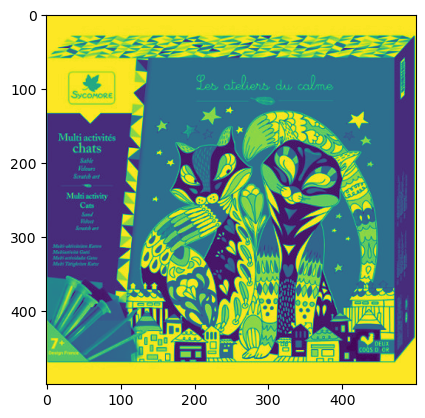

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987557917_product_294380992.jpg
Sharpness: 6875.031251973104


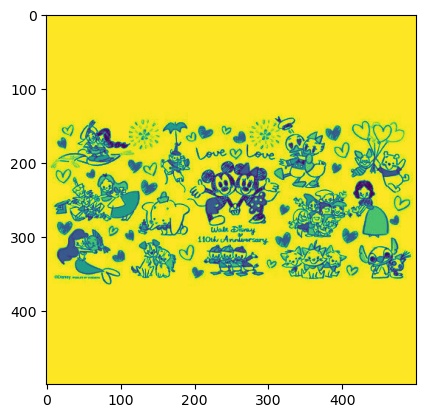

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1214827188_product_3463195192.jpg
Sharpness: 4095.656648


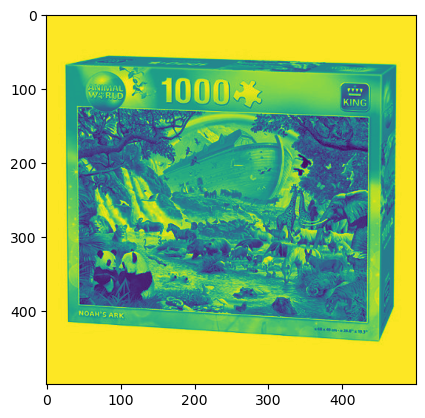

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1301790537_product_4151007570.jpg
Sharpness: 3845.0467079704163


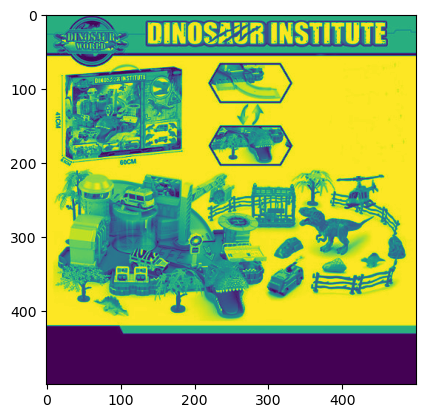

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1173819357_product_2932154233.jpg
Sharpness: 6274.6799059836


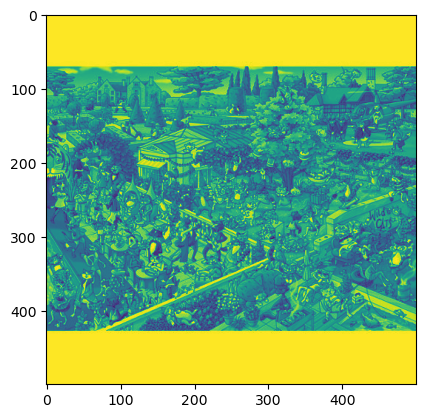

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242128607_product_3762645169.jpg
Sharpness: 4313.484848


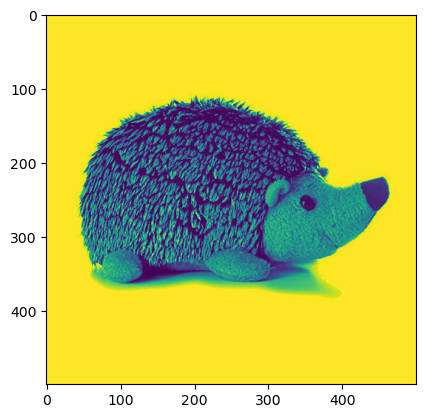

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240227539_product_3745009211.jpg
Sharpness: 5035.935744096496


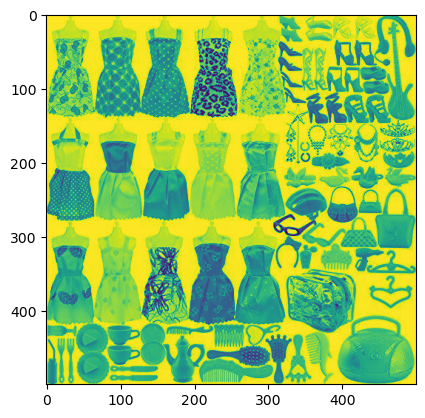

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_965080722_product_249468501.jpg
Sharpness: 9223.228232543743


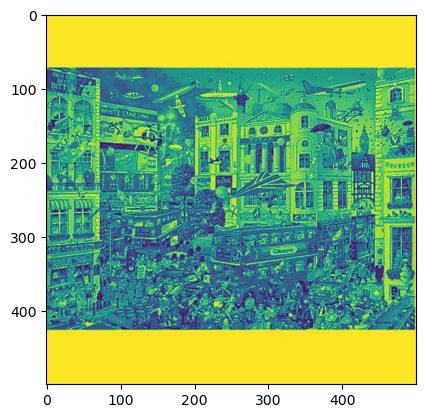

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242115114_product_3762611150.jpg
Sharpness: 4518.054568


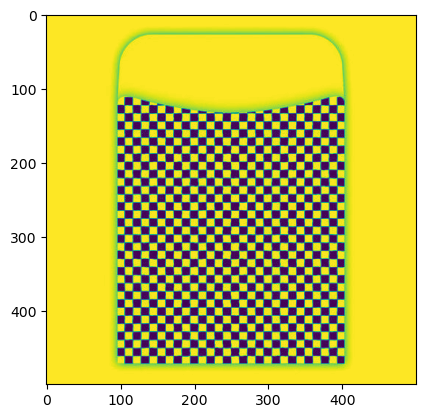

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215225380_product_3469578125.jpg
Sharpness: 3554.144875733745


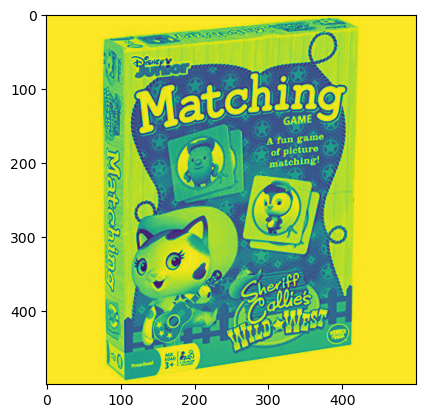

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987765143_product_294596454.jpg
Sharpness: 4101.3528239424


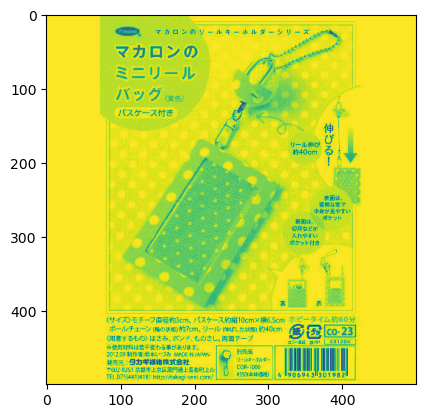

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1258086154_product_3883963977.jpg
Sharpness: 14650.432634776305


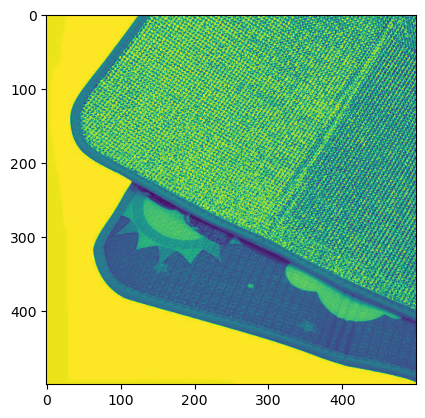

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215230991_product_3469590077.jpg
Sharpness: 3833.689791994816


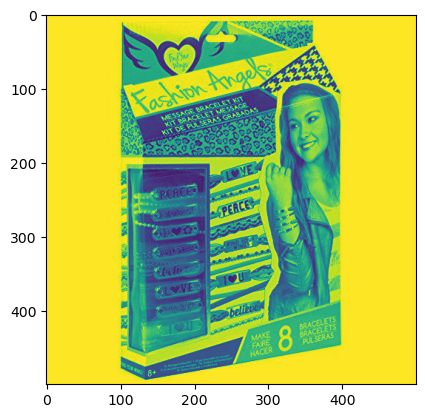

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_884201805_product_124408562.jpg
Sharpness: 3597.1368


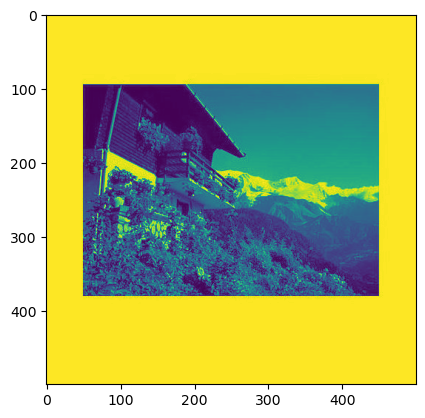

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1223464461_product_3580780129.jpg
Sharpness: 4115.867499512304


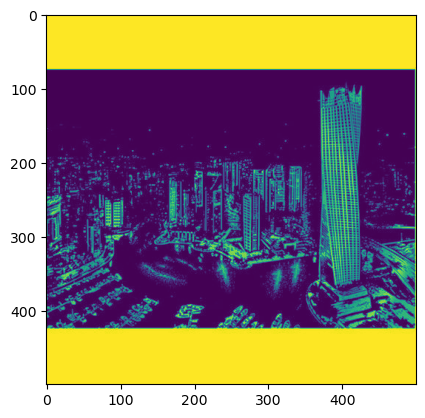

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204253985_product_3287295619.jpg
Sharpness: 4063.179632


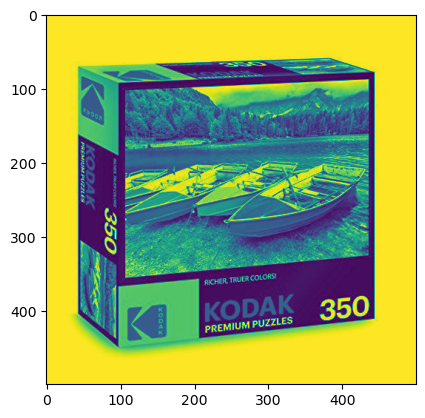

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242117013_product_3762612927.jpg
Sharpness: 5128.588962070977


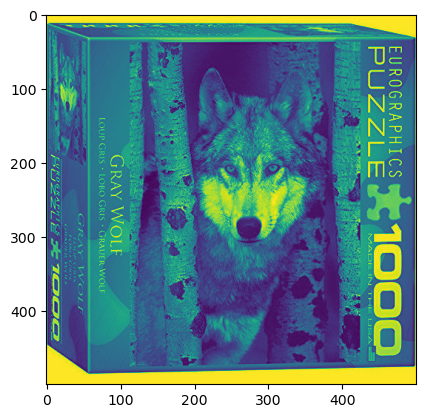

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1307425911_product_4171079683.jpg
Sharpness: 10.75892


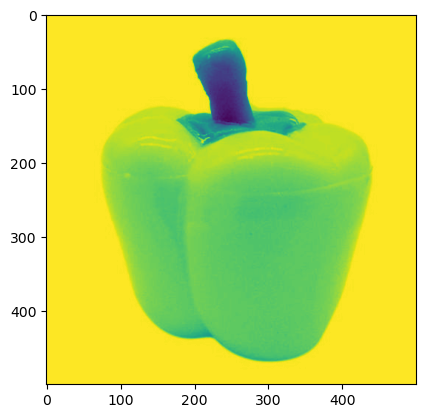

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1318087251_product_3784836484.jpg
Sharpness: 3964.483942781183


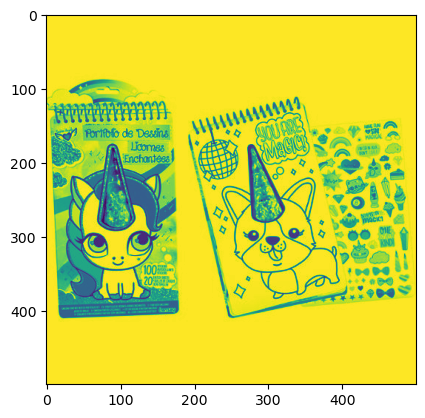

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204236671_product_3287276419.jpg
Sharpness: 3545.8473799883354


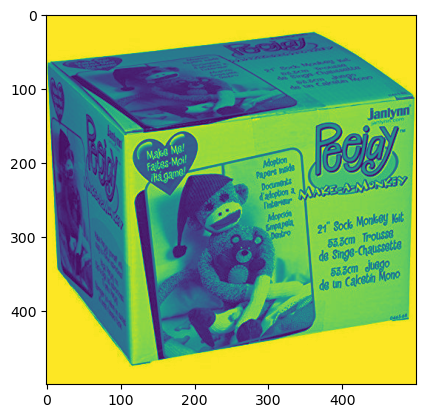

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1233300195_product_2861697390.jpg
Sharpness: 5752.609896


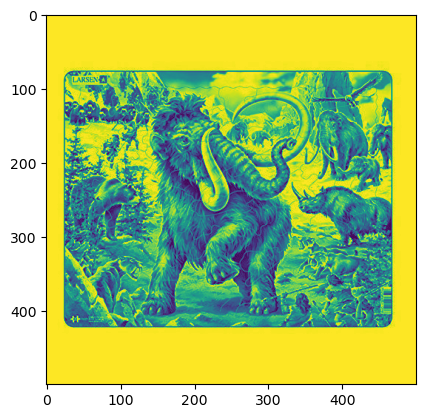

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240847050_product_3750089842.jpg
Sharpness: 10273.327898879217


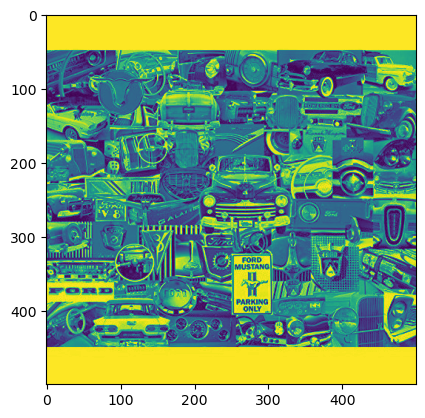

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1254501160_product_3861225265.jpg
Sharpness: 4365.413347721985


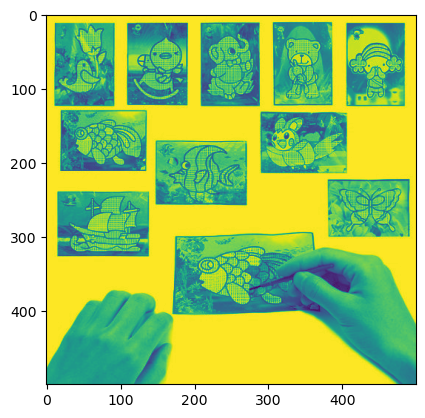

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987424670_product_294312823.jpg
Sharpness: 6550.838998883184


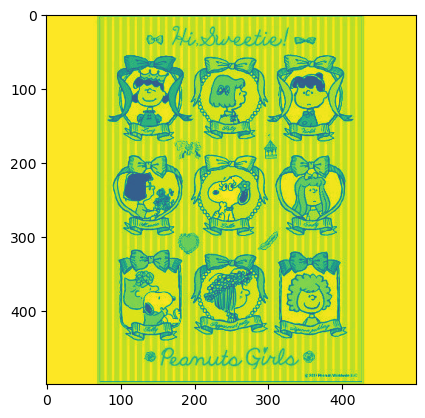

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215230334_product_3469589650.jpg
Sharpness: 7051.606022835137


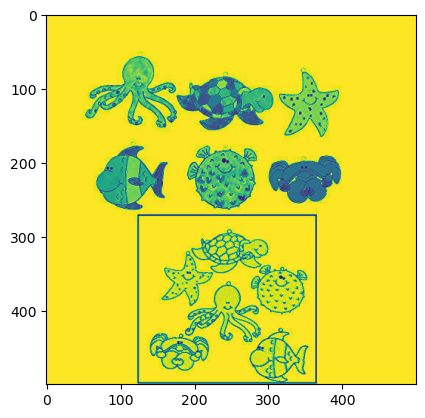

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1105748309_product_1856059376.jpg
Sharpness: 4251.897228703743


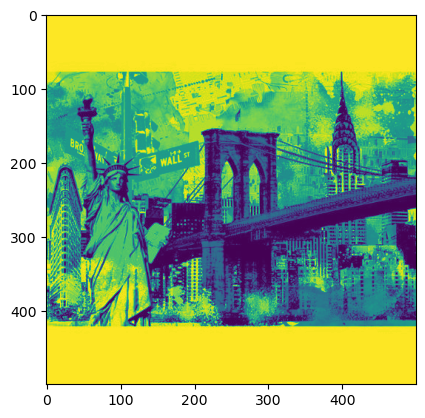

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204219250_product_3287230634.jpg
Sharpness: 5259.342367997697


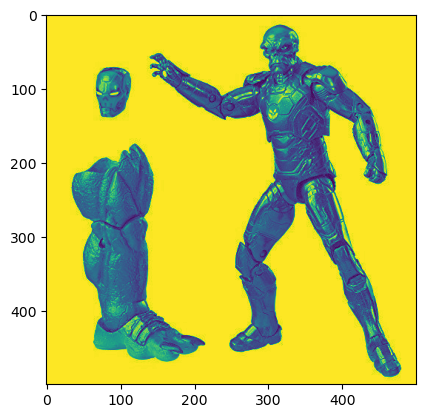

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204253708_product_3287295006.jpg
Sharpness: 5550.916419521136


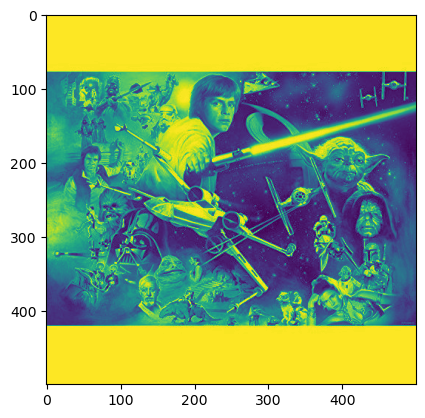

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987432265_product_294312552.jpg
Sharpness: 3570.275088


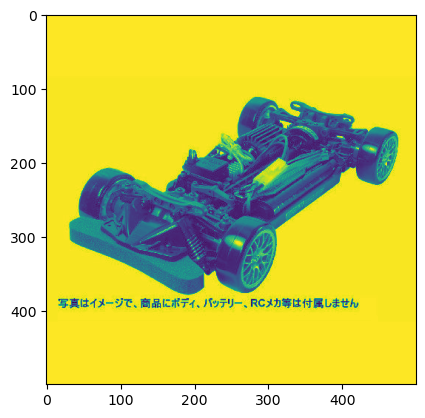

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1250157428_product_3830391286.jpg
Sharpness: 9.970872


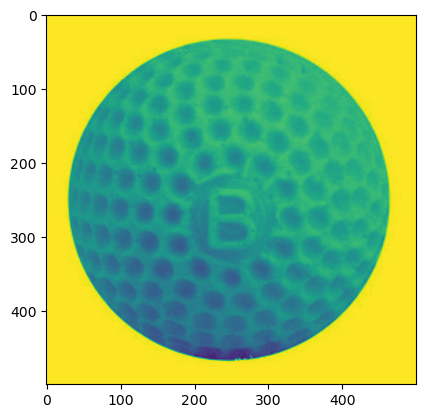

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1318723076_product_4215359656.jpg
Sharpness: 3534.05176


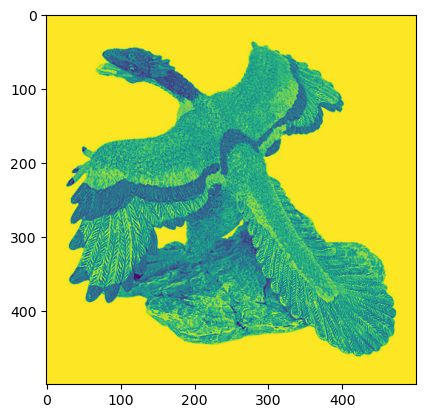

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1328278687_product_4250628404.jpg
Sharpness: 4077.7181942783354


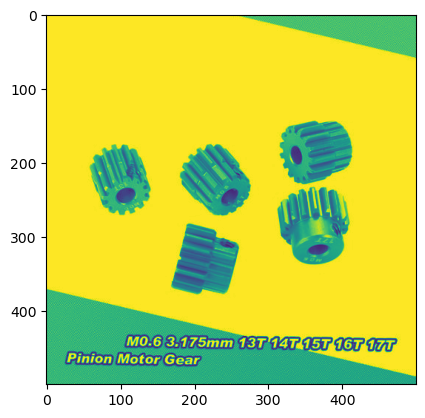

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987455157_product_294326420.jpg
Sharpness: 5114.262594588653


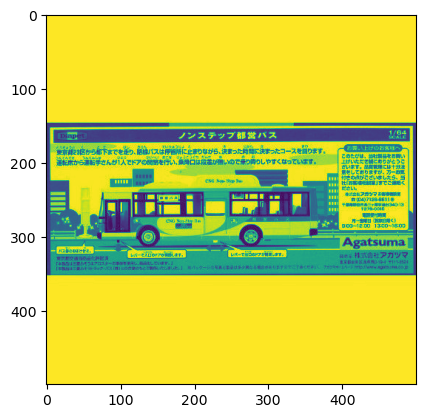

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242761426_product_3765674042.jpg
Sharpness: 3992.154072944496


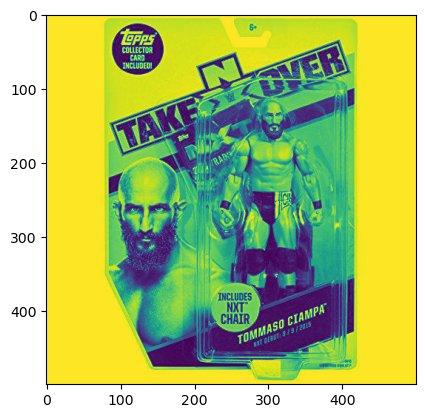

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1169778890_product_2878038864.jpg
Sharpness: 4.352464


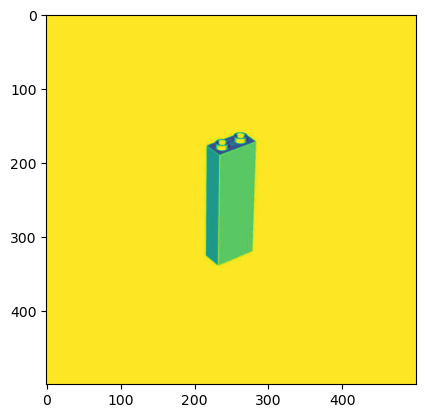

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_894286967_product_141356289.jpg
Sharpness: 8337.860448


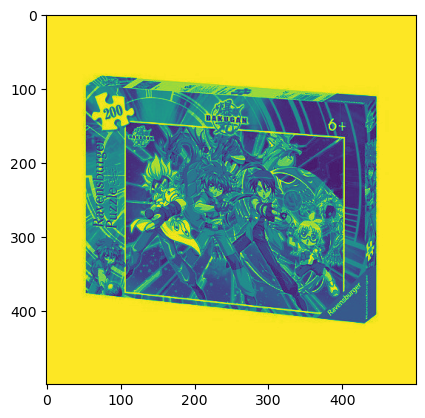

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215520937_product_3470059393.jpg
Sharpness: 3747.6876879948163


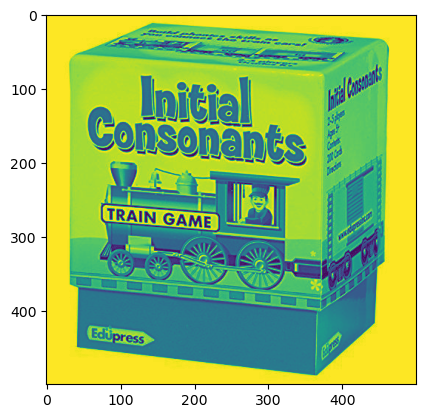

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240527430_product_3748209720.jpg
Sharpness: 4462.941146127104


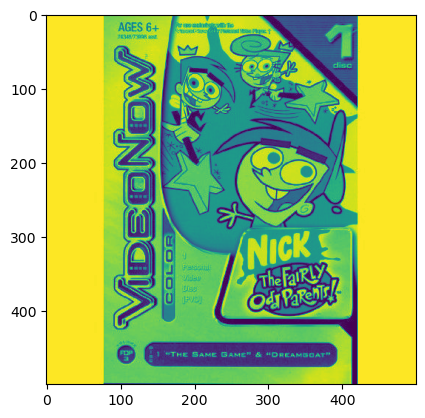

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_987510023_product_294334462.jpg
Sharpness: 7249.048017925056


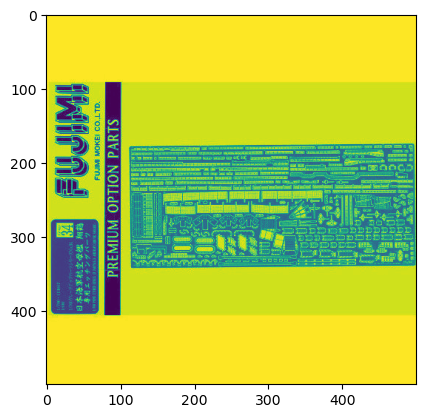

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215379892_product_3470111496.jpg
Sharpness: 11.079753323504004


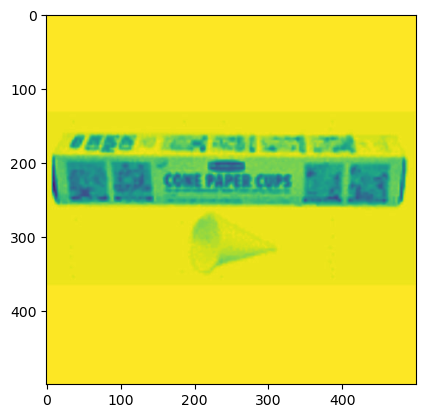

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1173819393_product_2932154237.jpg
Sharpness: 5843.385694322625


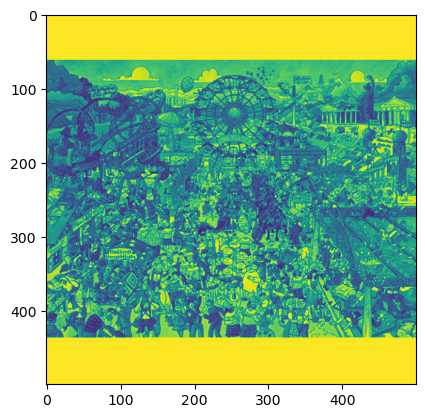

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1273993667_product_3995366811.jpg
Sharpness: 4627.696220189695


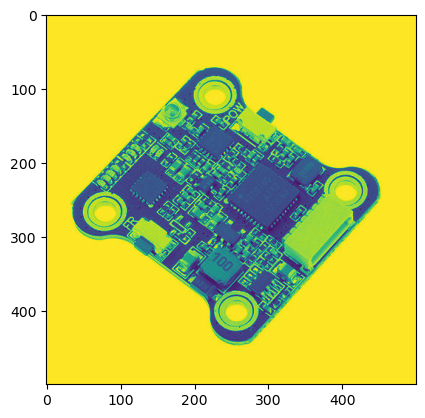

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_902306726_product_147467172.jpg
Sharpness: 3913.3934558704004


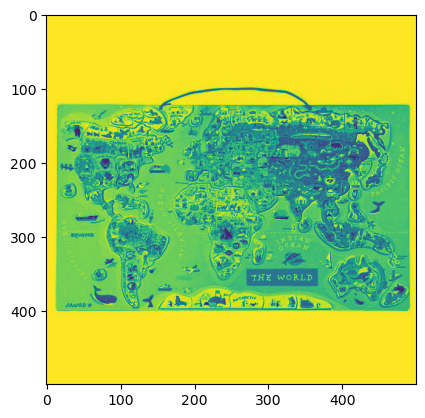

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1302249863_product_3793782107.jpg
Sharpness: 0.0


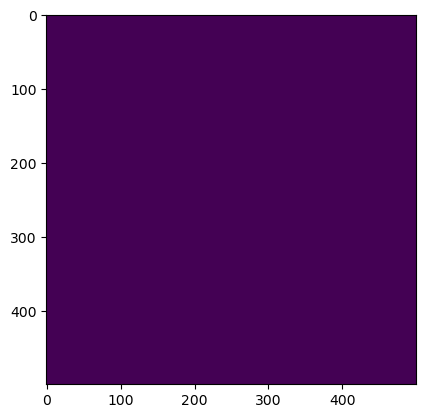

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1216132611_product_3477204682.jpg
Sharpness: 7380.554708380399


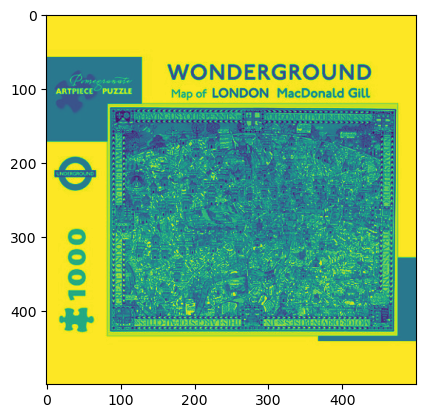

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1242760360_product_3765672382.jpg
Sharpness: 4871.340739575664


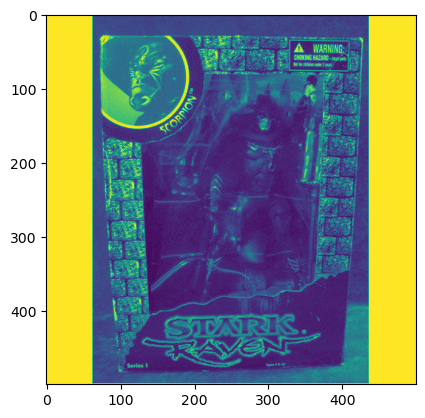

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1047102898_product_889359151.jpg
Sharpness: 4358.734423239616


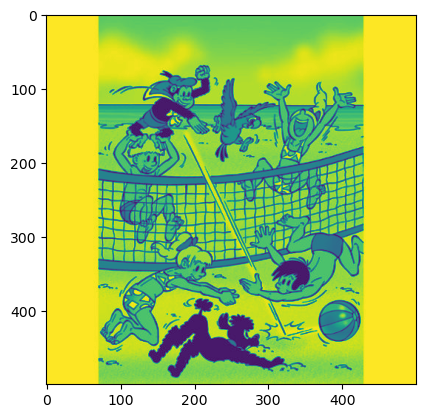

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240232504_product_3745064583.jpg
Sharpness: 3918.149576


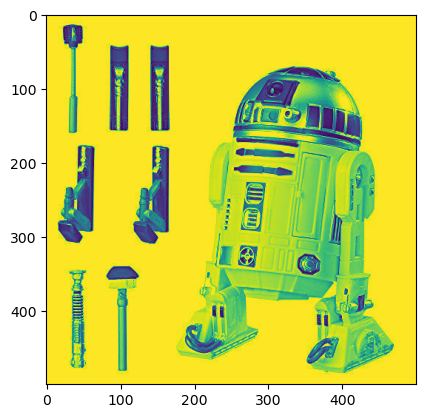

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204234958_product_3287270860.jpg
Sharpness: 3671.4261718168154


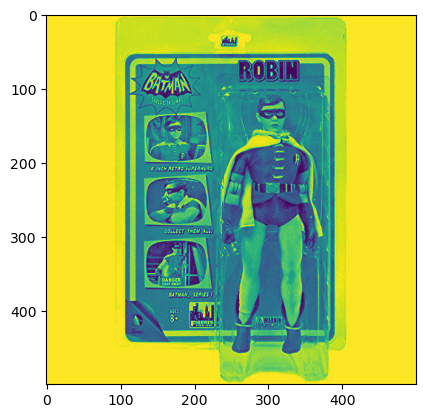

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204219692_product_3287231073.jpg
Sharpness: 4886.230807992255


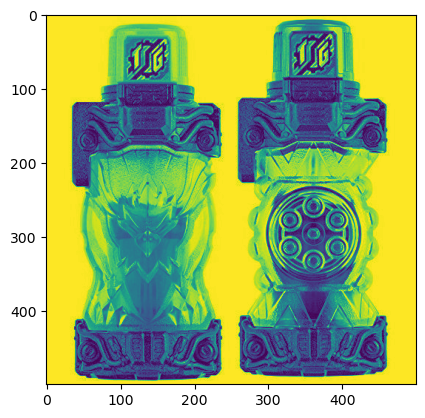

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1275473228_product_4000369650.jpg
Sharpness: 3642.949045116863


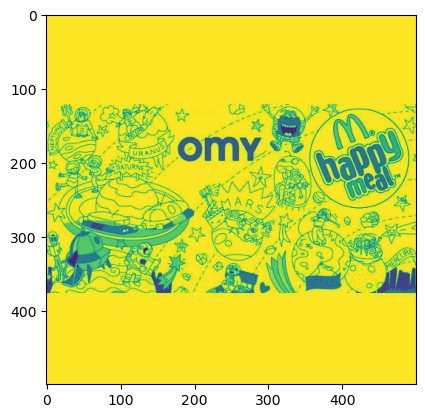

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1013199933_product_464655783.jpg
Sharpness: 4346.229165318898


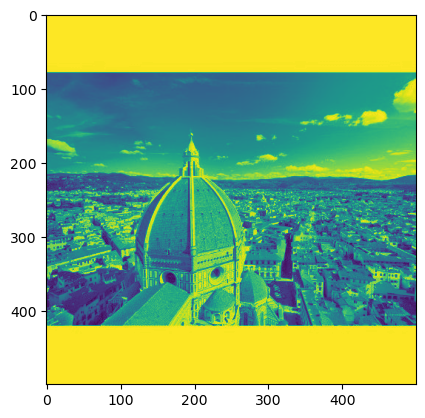

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1318959640_product_4213868749.jpg
Sharpness: 2.371656


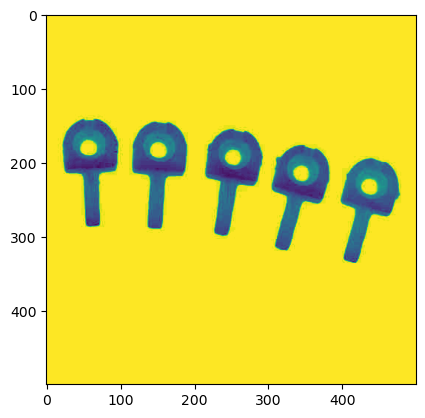

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1261269190_product_3898719959.jpg
Sharpness: 11.141576


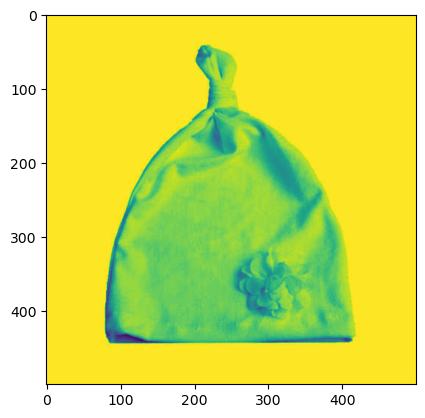

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1282351950_product_4056050102.jpg
Sharpness: 3576.1256318976


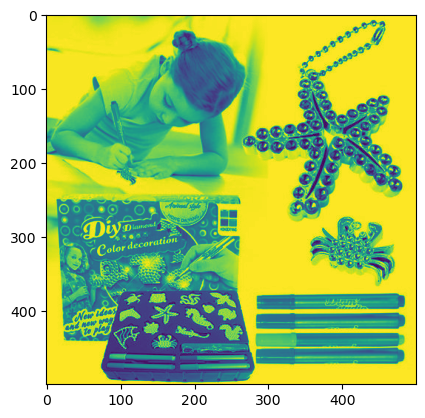

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204211324_product_3287151726.jpg
Sharpness: 3557.9917719953755


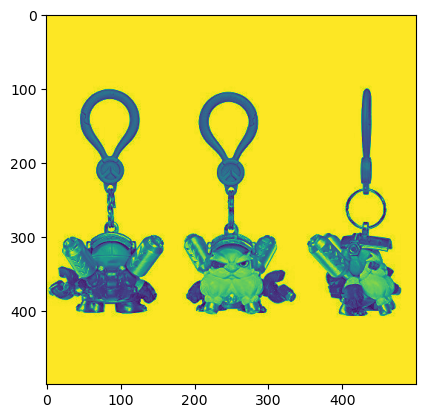

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1254495255_product_3810658421.jpg
Sharpness: 3881.564992


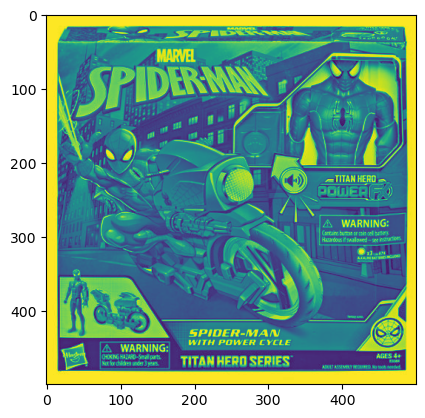

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1312708510_product_4195562870.jpg
Sharpness: 3759.9531786480634


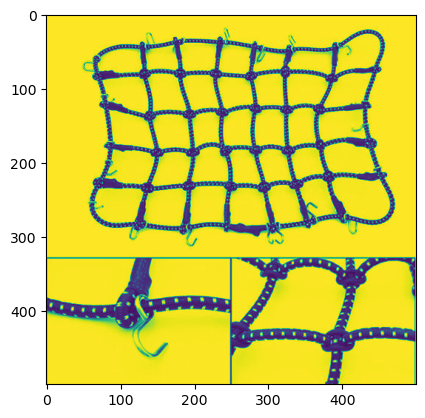

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1254566372_product_3862778781.jpg
Sharpness: 5432.0161797962255


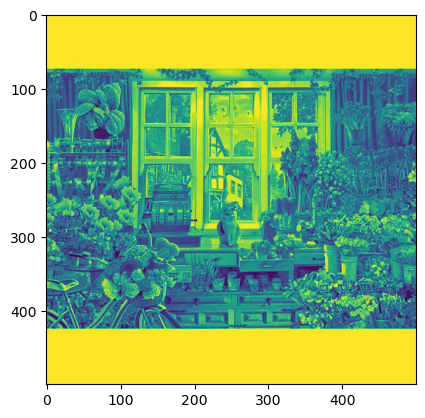

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215461019_product_3470166367.jpg
Sharpness: 5431.247539975663


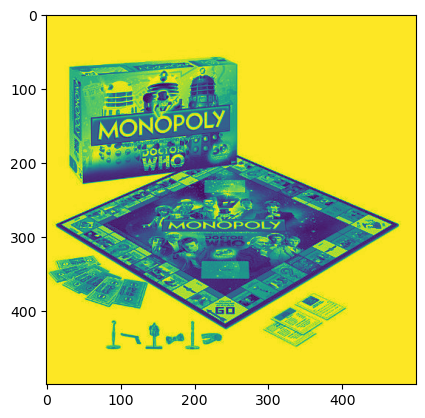

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204225014_product_3287237929.jpg
Sharpness: 7866.111936776303


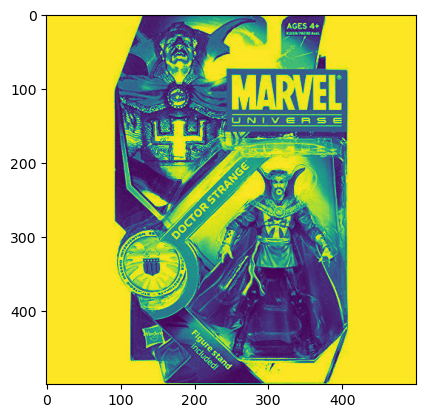

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1144107326_product_1123532939.jpg
Sharpness: 12.641144


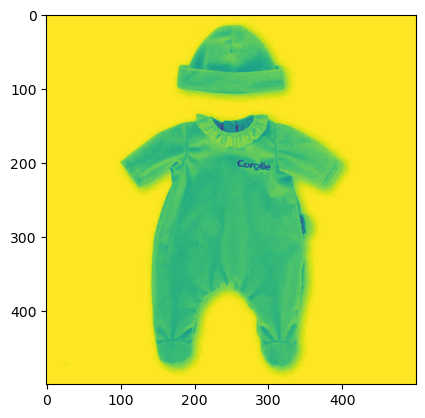

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1261313560_product_3898727534.jpg
Sharpness: 3764.542928


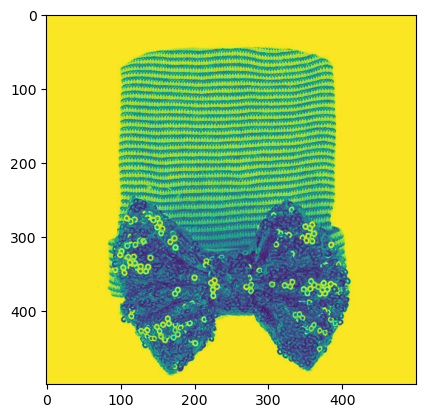

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1318750423_product_4215569304.jpg
Sharpness: 8.804232


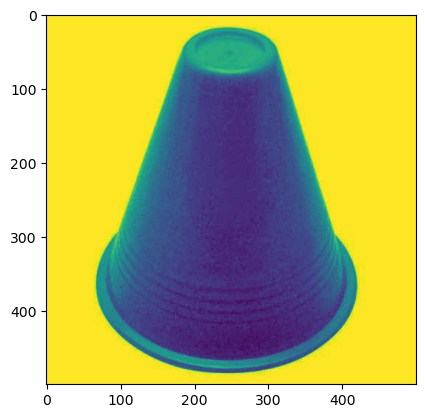

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1239769141_product_3740090995.jpg
Sharpness: 11471.370645381743


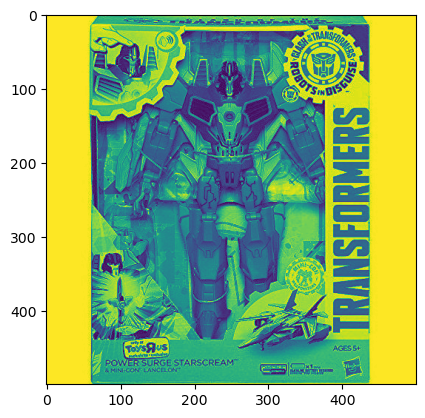

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1283761407_product_4058940500.jpg
Sharpness: 3665.432019958384


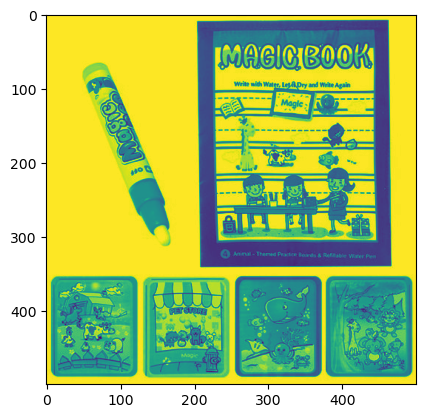

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204253507_product_3287294729.jpg
Sharpness: 4252.148199946176


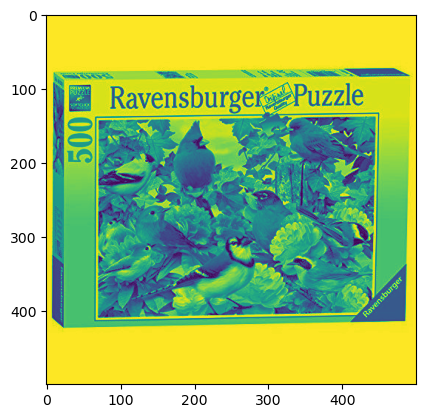

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_984973283_product_290111189.jpg
Sharpness: 6099.580248


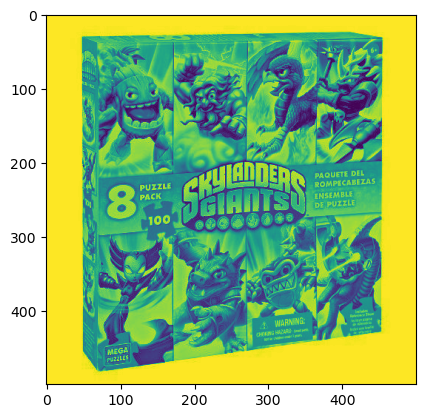

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1284280557_product_4063249230.jpg
Sharpness: 3883.8813476447845


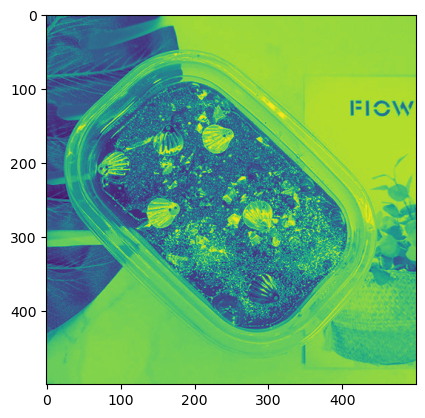

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1214827176_product_3463195185.jpg
Sharpness: 4111.055688


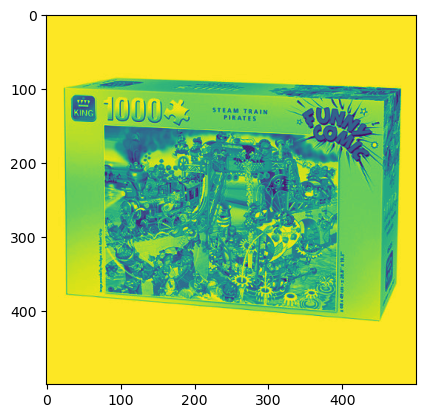

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215409880_product_3470137853.jpg
Sharpness: 5938.118775998978


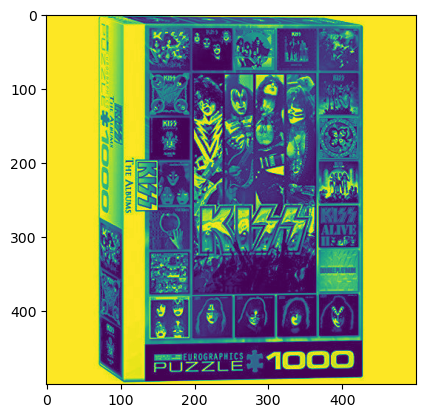

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1116859901_product_1965818610.jpg
Sharpness: 3925.2438958576


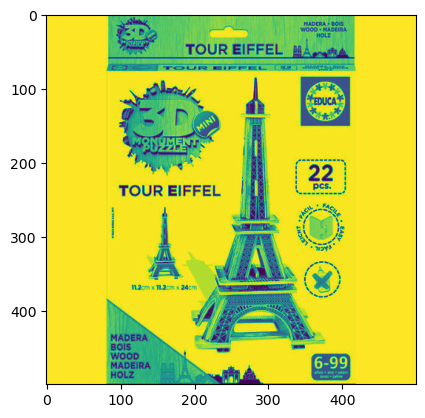

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1239701063_product_3739045268.jpg
Sharpness: 8026.946952


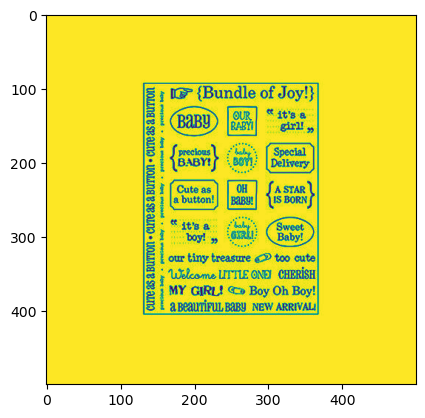

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1240523648_product_3748198322.jpg
Sharpness: 4070.963624


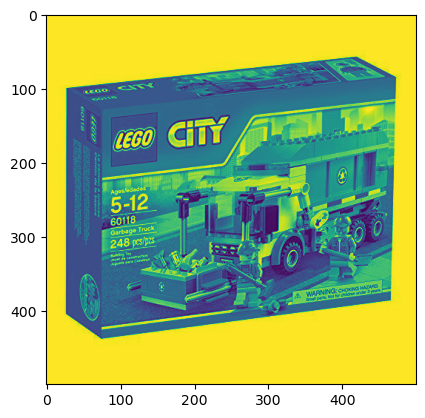

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1280129466_product_4042486779.jpg
Sharpness: 4627.696220189695


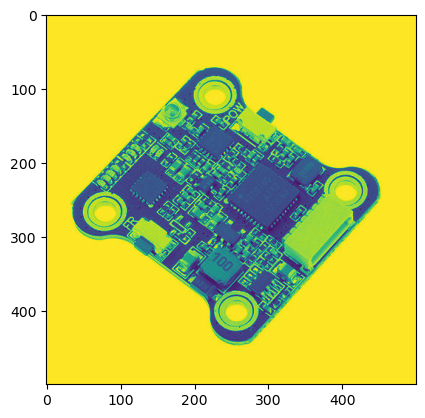

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215462691_product_3470166734.jpg
Sharpness: 4501.88519999


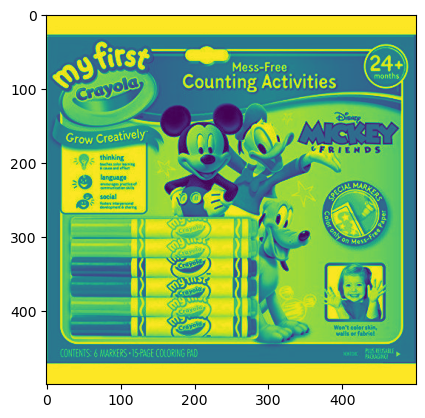

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1164148559_product_2779144310.jpg
Sharpness: 8.087735993600003


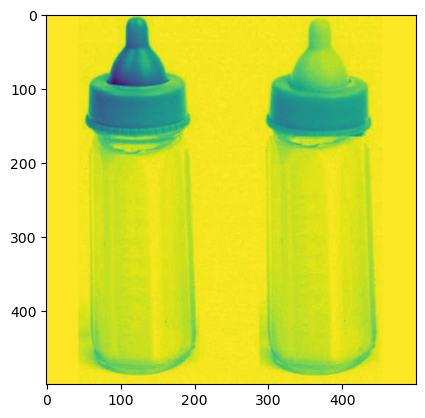

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1285132052_product_4066271074.jpg
Sharpness: 3665.432019958384


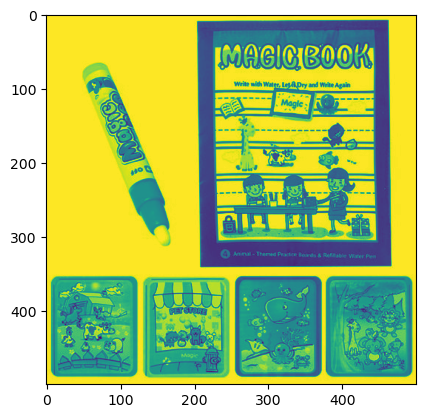

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1215530902_product_3470073419.jpg
Sharpness: 6965.756304


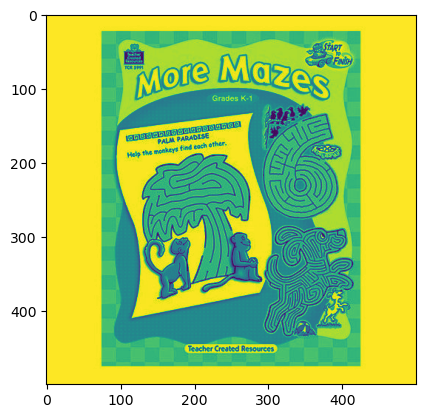

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_892982047_product_140386643.jpg
Sharpness: 4068.166848


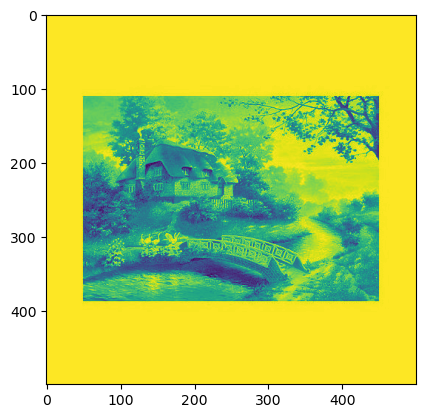

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1312603935_product_4195550042.jpg
Sharpness: 3.267352


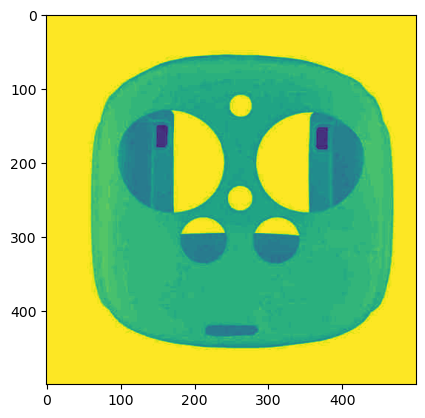

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1204254014_product_3287295631.jpg
Sharpness: 4999.342932525504


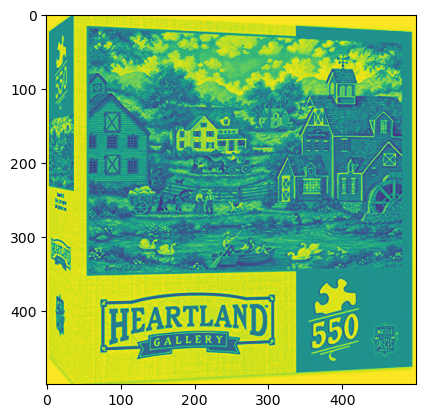

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1243839178_product_3776675830.jpg
Sharpness: 4155.807576


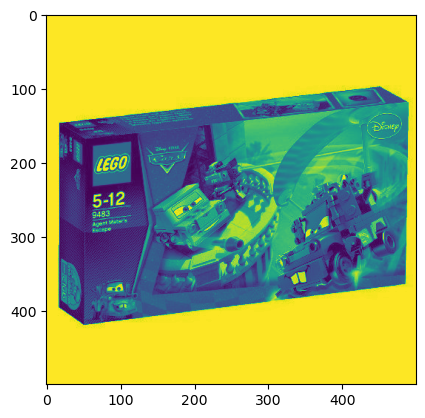

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1295847803_product_4126967225.jpg
Sharpness: 3707.669203404784


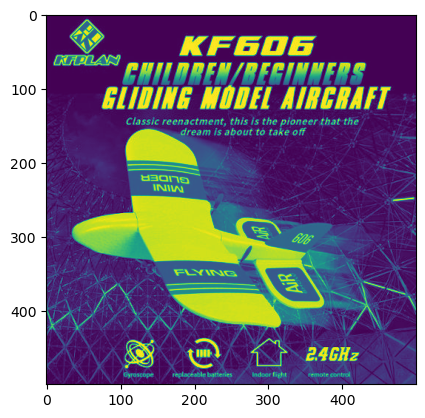

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1243842169_product_3776679691.jpg
Sharpness: 4406.894088


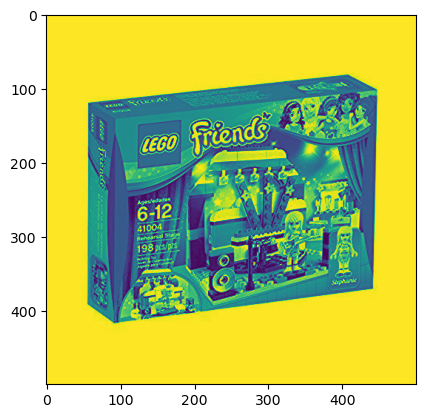

D:/Manuel/PROJET/Rakuten_Images_Classification_TensorFlow/data/images/image_train/image_1258046840_product_3883414928.jpg
Sharpness: 8054.877806444399


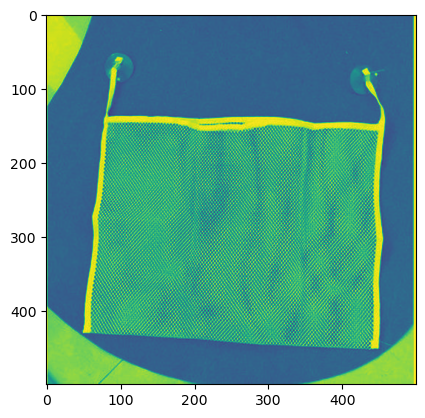

4870
(4870, 500, 500)


In [10]:
import os
import cv2
import numpy as np

from PIL import Image

def measure_sharpness(image):
    laplacian = cv2.Laplacian(image, cv2.CV_64F)
    return np.var(laplacian)

# Définir le chemin du dossier contenant les images
#folder_path = "C:\\Users\\MANUADMIN\\python\\DataScience\\Datascientest\\PROJET\\images\\image_train"
#folder_path = "C:\\Users\\shaky\\anaconda3\\envs\\Datascientest\\Datascience\\PROJET\\images\\image_train"
folder_path = get_RACINE_IMAGES() 


df_img=df[df['prdtypecode'].isin([40,50,60,1280])]
#print(df_img.head())

# Charger les images et les stocker dans un tableau
image_list = []


for filename in df_img['nom_image'][df_img['prdtypecode']==1280]:
    #print(os.path.join(folder_path, filename))
    #image = Image.open(os.path.join(folder_path, filename))
    #image.show()
    img = cv2.imread(os.path.join(folder_path, filename))
    if img is not None:
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        sharpness = measure_sharpness(gray)
        #print('Sharpness:', sharpness)
        if (sharpness < 15) or  (sharpness > 3500) :
            print(os.path.join(folder_path, filename))
            print('Sharpness:', sharpness)
            plt.imshow(gray)
            plt.show()
        image_list.append(gray)



# Convertir la liste d'images en un tableau numpy
images = np.array(image_list)
print(len(images))
print(images.shape)


# Afficher la première image
image=image_list[0]
#plt.imshow(image)
#plt.show()

#sharpness = measure_sharpness(image)
#print('Sharpness:', sharpness)




In [8]:
def measure_sharpness(image):
    laplacian = cv2.Laplacian(image, cv2.CV_64F)
    return np.var(laplacian)

sharpness = measure_sharpness(image)
print('Sharpness:', sharpness)


Sharpness: 431.738072


### Chargement des Images et Mesure de la Netteté par catégorie

L'objectif est d'examiner s'il existe un lien entre la netteté des images et les catégories de produits auxquelles elles appartiennent. En analysant ces variations de netteté, nous cherchons à comprendre comment la qualité de l'image peut affecter ou refléter les différences entre les catégories de produits.

Un graphique à boîtes (boxplot) est créé pour comparer la distribution de la netteté entre les différentes catégories de produit.


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84916 entries, 0 to 84915
Data columns (total 7 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Id           84916 non-null  int64 
 1   designation  84916 non-null  object
 2   description  55116 non-null  object
 3   productid    84916 non-null  int64 
 4   imageid      84916 non-null  int64 
 5   prdtypecode  84916 non-null  int64 
 6   nom_image    84916 non-null  object
dtypes: int64(4), object(3)
memory usage: 4.5+ MB
None
Catégorie :  10 livres
Catégorie :  40 jeux video pour pc et consoles
Catégorie :  50  accesoires jeux video
Catégorie :  60 consoles de jeux video
Catégorie :  1140 produits derives “geeks” et figurines
Catégorie :  1160 cartes collectionables
Catégorie :  1180 figurines collectionables pour jeux de societe
Catégorie :  1280 jouets, peluches, poupees
Catégorie :  1281 jeux de societe/cartes
Catégorie :  1300 Petites voitures (jouets) et maquettes
Catégorie :  130

<Figure size 1200x600 with 0 Axes>

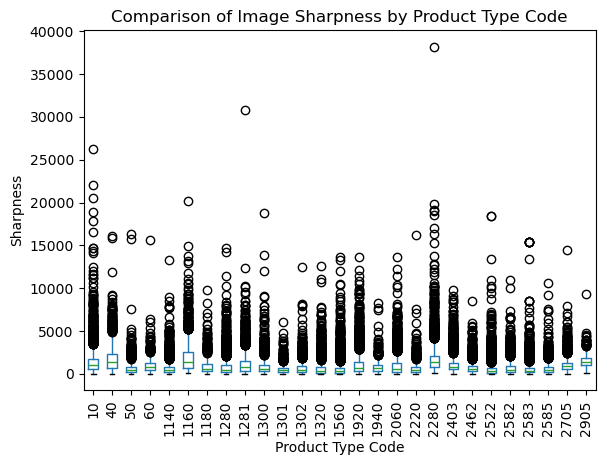

In [23]:
import cv2
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt

# Fonction pour calculer la netteté d'une image
def calculate_sharpness(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    laplacian_var = cv2.Laplacian(gray, cv2.CV_64F).var()
    return laplacian_var

# Créer une copie du DataFrame original
df_img = df.copy()
print(df_img.info())

# Dossier contenant toutes les images
folder_path = get_RACINE_IMAGES() # Chemin du dossier contenant les images

# Dictionnaire pour stocker les résultats
results = {'prdtypecode': [], 'nom_image': [], 'sharpness': []}

# Parcourir les catégories et calculer la netteté
for c in cat:
    print("Catégorie : ", c, catdict[c])
    for filename in df_img[df_img['prdtypecode'] == c]['nom_image']:
        img_path = os.path.join(folder_path, filename)
        img = cv2.imread(img_path)
        if img is not None:
            sharpness = calculate_sharpness(img)
            results['prdtypecode'].append(c)
            results['nom_image'].append(filename)
            results['sharpness'].append(sharpness)
        else:
            print("Erreur lors du chargement de l'image :", img_path)

# Convertir les résultats en DataFrame
df_sharpness = pd.DataFrame(results)

df_sharpness.to_csv('Dfsharpness.csv')

# Calculer les statistiques par catégorie
stats_by_category = df_sharpness.groupby('prdtypecode')['sharpness'].describe()

# Afficher les statistiques
print(stats_by_category)

# Visualiser les résultats
if not df_sharpness.empty:
    plt.figure(figsize=(12, 6))
    df_sharpness.boxplot(column='sharpness', by='prdtypecode', grid=False, rot=90)
    plt.title('Comparison of Image Sharpness by Product Type Code')
    plt.suptitle('')
    plt.xlabel('Product Type Code')
    plt.ylabel('Sharpness')
    plt.show()
else:
    print("Pas de données à afficher.")


#### visualisation de la distribution des valeurs de netteté dans l'ensemble des images

sharpness
(0.0, 500.0]          36778
(500.0, 1000.0]       21676
(1000.0, 1500.0]      11121
(1500.0, 2000.0]       5963
(2000.0, 2500.0]       3637
                      ...  
(36000.0, 36500.0]        0
(36500.0, 37000.0]        0
(37000.0, 37500.0]        0
(37500.0, 38000.0]        0
(38000.0, 38500.0]        1
Name: count, Length: 77, dtype: int64


Text(0, 0.5, 'Number of Images')

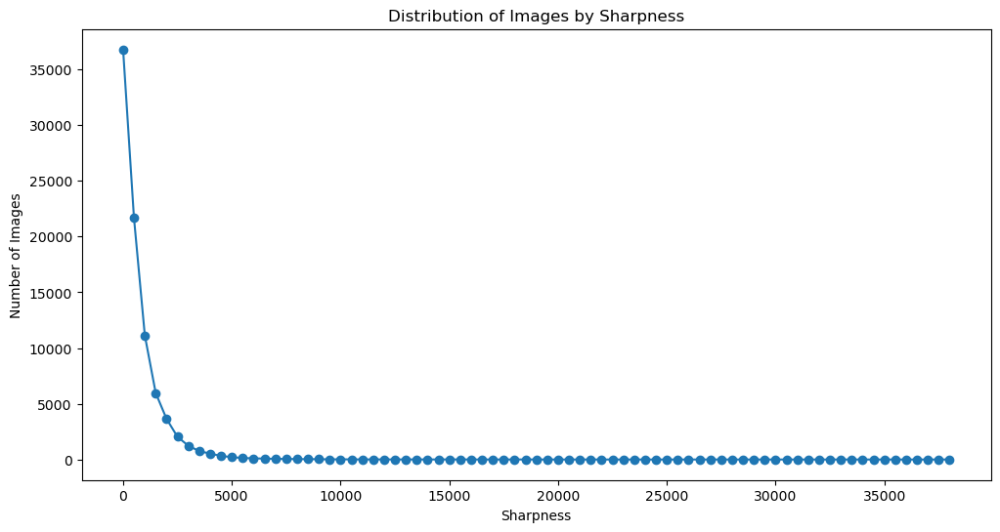

In [30]:
df_sharpness=pd.read_csv('Dfsharpness.csv')
sharpness_bins = np.arange(0, df_sharpness['sharpness'].max() + 500, 500)

# Compter le nombre d'images dans chaque intervalle de netteté
sharpness_distribution = pd.cut(df_sharpness['sharpness'], bins=sharpness_bins).value_counts().sort_index()

# Afficher les données de distribution
print(sharpness_distribution)

# Tracer le graphique en courbes
plt.figure(figsize=(12, 6))
plt.plot(sharpness_bins[:-1], sharpness_distribution, marker='o')
plt.title('Distribution of Images by Sharpness')
plt.xlabel('Sharpness')
plt.ylabel('Number of Images')

#### visualisation de la distribution des valeurs de netteté par catégorie

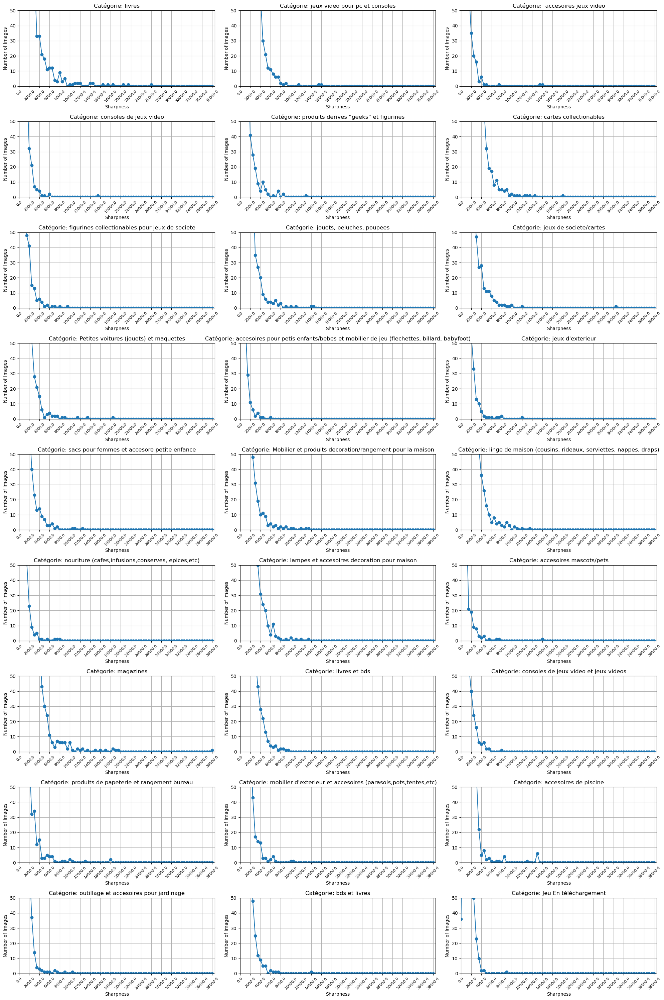

In [32]:
df_sharpness=pd.read_csv('Dfsharpness.csv')
# Définir les intervalles de netteté avec un pas de 500
sharpness_bins = np.arange(0, df_sharpness['sharpness'].max() + 500, 500)

# Créer la figure pour les sous-graphiques
fig, axes = plt.subplots(nrows=9, ncols=3, figsize=(20, 30))
axes = axes.flatten()  # Aplatir la matrice des axes pour itérer facilement

# Parcourir chaque catégorie pour tracer un graphique
for i, c in enumerate(cat):
    ax = axes[i]
    cat_data = df_sharpness[df_sharpness['prdtypecode'] == c]['sharpness']
    
    # Compter le nombre d'images dans chaque intervalle de netteté pour cette catégorie
    sharpness_distribution = pd.cut(cat_data, bins=sharpness_bins).value_counts().sort_index()
    
    # Tracer le graphique
    ax.plot(sharpness_bins[:-1], sharpness_distribution, marker='o')
    ax.set_title(f'Catégorie: {catdict[c]}')
    ax.set_xlabel('Sharpness')
    ax.set_ylabel('Number of Images')
    ax.grid(True)
    ax.set_xlim([sharpness_bins[0], sharpness_bins[-1]])
    ax.set_ylim([0, 50])

    # Ajuster les étiquettes de l'axe x
    ax.set_xticks(sharpness_bins[::4])  # Affiche une étiquette tous les 1000 unités
    ax.set_xticklabels(sharpness_bins[::4], rotation=45, fontsize=8)

# Masquer les axes inutilisés si le nombre de catégories est inférieur à 27
for j in range(len(cat), len(axes)):
    fig.delaxes(axes[j])

# Ajuster l'espacement entre les sous-graphiques
plt.tight_layout()
plt.show()
